In [1]:
%load_ext autoreload

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

import matplotlib.colors as colors
import matplotlib
import os

import cv2
from IPython.display import HTML

matplotlib.rcParams['animation.embed_limit'] = 100.0

In [2]:
%autoreload 

from DDFNN.dffnn import fastVel

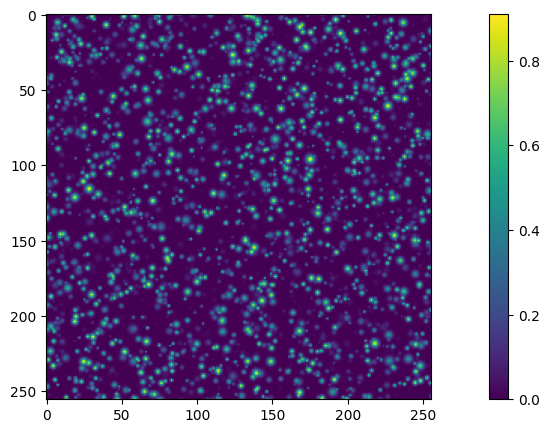

In [5]:

def readtif(dir_file):
    return plt.imread(dir_file)

class secImage():
    def __init__(self, dir_base, tr=0.0, resmean=True) -> None:
        self.tr = tr
        self.dir = dir_base
        self.images = [os.path.join(dir_base, e) for e in os.listdir(dir_base)]
        self.mean_image = 0
        self.slice_image = 0
        if resmean:
            mimag, simag = self.calculate_mean_image(nx = self(0).shape[0]//2)
            self.mean_image = mimag
            self.slice_image =simag

    def __len__(self):
        return len(self.images)
    
    def calculate_mean_image(self, nx):
        N = len(self.images)
        res = 255
        res2 = []
        for i in range(N):
            img = self(i)
            res = np.minimum(img, res)
            res2.append(img[:,int(nx)])
        
        return res, np.array(res2).T
    

    def __getitem__(self, index):
        res = self(index)
        
        # kernel = (3, 3)
        # res = cv2.GaussianBlur(res, kernel, 0)
        
        # clahe_op = cv2.createCLAHE(clipLimit=45)
        # res = clahe_op.apply(res)        
        return res/(255.)
    
    def __call__(self, index):
        res = readtif(self.images[index])
        res = cv2.cvtColor(res, cv2.COLOR_RGB2GRAY)
        # res = res[49:1611,135:2267]
        # res = res[:1290,:]
        
        # res = res-self.mean_image
        # res = np.maximum(res,0)
        res[res<self.tr] = 0
        return res
    
main_path = "examples/example 2/"
imgs = secImage(main_path, resmean=False)
plt.figure(figsize=(15,5))
plt.imshow(imgs[2])
plt.colorbar()
plt.show()

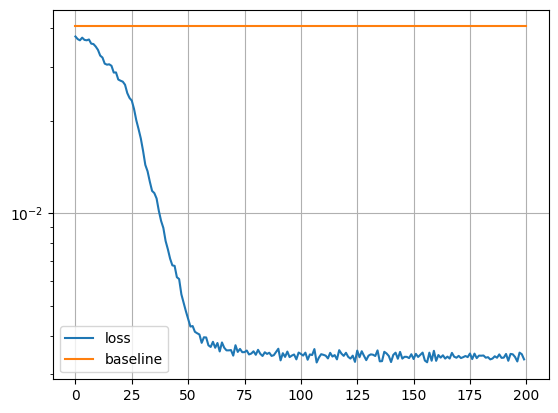

In [ ]:
params = {
    "random_seed": 123,
    "nB":200,
    "scaler":100,
    "nlayers":1,
    "sizelayer":100, 
    "lamb":[0, 0],
    "its":100,
    "batch_size":30000,
    "lr":1e-3,
    "tr":0.0,
    }
net = None
U = np.zeros([len(imgs)-1,*imgs[0].shape, 2], dtype=np.float32)
for i in range(len(imgs)-1):
    img1 = imgs[i]
    img2 = imgs[i+1]
    x = np.arange(img1.shape[0])
    y = np.arange(img1.shape[1])
    X, Y = np.meshgrid(y, x[::-1])

    net, _, vel = fastVel(img1, img2, net=net, verbose= i==0, **params)
    Ux = vel[:,0].reshape(img1.shape)[::-1]
    Uy = -vel[:,1].reshape(img1.shape)[::-1]
    U[i,...,0] = Ux
    U[i,...,1] = Uy

    params["its"]=2


In [22]:
sts = 5
step = 20
scale = 3
skip= 2

fig, ax = plt.subplots(2, 2, figsize=(10,10*img1.shape[0]/img1.shape[1]))
nmax, nmin = np.linalg.norm(U, axis=-1).max(), np.linalg.norm(U, axis=-1).min()
xmax, xmin = U[...,0].max(),U[...,0].min()
ymax, ymin = U[...,1].max(),U[...,1].min()
levelsux = np.linspace(xmin, xmax, 31)
levelsuy = np.linspace(ymin, ymax, 31)
levelsun = np.linspace(nmin, nmax, 31)
for a in ax.flatten(): a.axis("off")
fig.tight_layout()
def run(i):
    i *=skip
    for a in ax.flatten(): a.clear();a.axis("off")
    # cont = ax[0,0].imshow(U[i][...,0], origin="lower")
    cont = ax[0,0].contourf(X, Y, U[i][...,0], levels=levelsux, cmap="RdBu",
                            norm=colors.TwoSlopeNorm(0, vmin=xmin, vmax=xmax))
    cont = ax[0,1].contourf(X, Y, U[i][...,1], levels=levelsuy, cmap="RdBu", 
                            norm=colors.TwoSlopeNorm(0, vmin=ymin, vmax=ymax))
    cont = ax[1,0].imshow(imgs[i][::-1], origin="lower", cmap="Greys_r")
    cont = ax[1,0].quiver(X[sts::step,::step], Y[sts::step,::step], 
            (U[i][...,0])[sts::step,::step],
                (U[i][...,1])[sts::step,::step],
                color="r",
            pivot='tail',
            scale_units="xy",
            scale=1/scale,
            angles='xy'#, scale_units='xy', scale=1/scale
            )
    cont = ax[1,1].contourf(X, Y, np.linalg.norm(U[i], axis=-1), levels=levelsun, cmap="bwr", vmin=nmin, vmax=nmax)
    for a in ax.flatten(): a.axis("scaled")
    return cont,
plt.close()

ani = animation.FuncAnimation(fig, run, np.minimum(100, (len(imgs)-1)//skip), interval=skip*1000/24)
HTML(ani.to_jshtml())